In [1]:
!pip install psycopg2-binary

     |████████████████████████████████| 2.2 MB 13.8 MB/s eta 0:00:01


In [4]:
!pip install textblob


     |████████████████████████████████| 636 kB 12.7 MB/s eta 0:00:01


In [5]:
import pandas as pd
import numpy as np
from textblob import TextBlob
import feedparser
import requests
import json
import yaml

In [6]:
newsurls = {
    'globenewswire-us':           'http://www.globenewswire.com/RssFeed/country/United%20States/feedTitle/GlobeNewswire%20-%20News%20from%20United%20States',
}

In [7]:
newsurls

{'globenewswire-us': 'http://www.globenewswire.com/RssFeed/country/United%20States/feedTitle/GlobeNewswire%20-%20News%20from%20United%20States'}

In [8]:
def parse_rss( rss_url ):
    return feedparser.parse( rss_url ) 
    
# Function grabs the rss feed headlines (titles) and returns them as a list
def get_headlines( rss_url ):
    headlines = []
    feed = parse_rss( rss_url )
    for newsitem in feed['items']:
        headlines.append(newsitem['title'])
    return headlines
def get_summaries( rss_url ):
    summaries = []
    feed = parse_rss( rss_url )
    for newsitem in feed['items']:
        summaries.append(newsitem['summary'])
    return summaries
def get_entries( rss_url ):
    entries = []
    feed = parse_rss( rss_url )
    for newsitem in feed['items']:
        entries.append(newsitem.keys())
    return entries

In [11]:
entries = []
# Iterate over the feed urls
for key,url in newsurls.items():
    # Call getHeadlines() and combine the returned headlines with allheadlines
    entries.extend( get_entries( url ) )
print(entries[0])


dict_keys(['id', 'guidislink', 'link', 'links', 'title', 'title_detail', 'summary', 'summary_detail', 'published', 'published_parsed', 'dc_identifier', 'language', 'publisher', 'publisher_detail', 'contributors', 'dc_modified', 'tags', 'dc_keyword'])


In [21]:
allheadlines = []
summaries = []

# Iterate over the feed urls
for key,url in newsurls.items():
    # Call getHeadlines() and combine the returned headlines with allheadlines
    allheadlines.extend( get_headlines( url ) )
    summaries.extend( get_summaries( url ) )

In [22]:
for hl in allheadlines:
    print(hl)

Hyaluronic Acid Market Demand to Nearly Double as Sales in Pharmaceutical Industry to Account for 1/3rd of Overall Sales | Future Market Insights, Inc.
Increasing Seaborne Trade and Shipping Industry Spur the Global Marine Lubricants Market, States Fact.MR
EMTECH Introduces The  G.R.E.E.N. CBDC Framework(™)
New REDUCE-IT® Data Show VASCEPA®/VAZKEPA® (icosapent ethyl) Reduced Cardiovascular Events in Patients Who Are Current or Former Smokers
HII Ceremoniously Lays Keel Of Enterprise (CVN 80) Aircraft Carrier
LATCH, INC. INVESTIGATION ALERT: Wolf Haldenstein Adler Freeman & Herz LLP is investigating potential securities fraud claims on behalf of the shareholders of Latch, Inc.
Alation nommée dans la Constellation ShortList™ pour la gestion des métadonnées, le catalogage des données et la gouvernance des données pour la troisième année consécutive
Alation zum dritten Jahr in Folge in die Constellation ShortList™ für Metadatenmanagement, Datenkatalogisierung und Datenverwaltung aufgenomme

In [23]:
contentText = allheadlines[1]
print(contentText)

Increasing Seaborne Trade and Shipping Industry Spur the Global Marine Lubricants Market, States Fact.MR


In [26]:
headType = "text/raw"
token = 'oSyQfYcRShExGJmJPXRgr4kOFAsIHqoJ'
url = "https://api-eit.refinitiv.com/permid/calais"
payload = contentText.encode('utf8')
headers = {
    'Content-Type': headType,
    'X-AG-Access-Token': token,
    'outputformat': "application/json"
    }
#  The daily limit is 5,000 requests, and the concurrent limit varies by API from 1-4 calls per second. 
TRITResponse = requests.request("POST", url, data=payload, headers=headers)
# Load content into JSON object
JSONResponse = json.loads(TRITResponse.text)
# print(json.dumps(JSONResponse, indent=4, sort_keys=True))

In [33]:
for key in JSONResponse:
    if ('_typeGroup' in JSONResponse[key]):
        if JSONResponse[key]['_typeGroup'] == 'entities':
            print(JSONResponse[key]['_type'] + ", " + JSONResponse[key]['name'])

Company, Seaborne Trade
Company, GLOBAL MARINE


In [35]:
print('====RIC====')
print('RIC')
for entity in JSONResponse:
    for info in JSONResponse[entity]:
        if (info =='resolutions'):
            for companyinfo in (JSONResponse[entity][info]):
                if 'primaryric' in companyinfo:
                    symbol = companyinfo['primaryric']
                    print(symbol)


====RIC====
RIC
RIG.N


In [36]:
print(symbol)
print('====Topics====')
print('Topics, Score')
for key in JSONResponse:
    if ('_typeGroup' in JSONResponse[key]):
        if JSONResponse[key]['_typeGroup'] == 'topics':
            print(JSONResponse[key]['name'] + ", " + str(JSONResponse[key]['score']))


RIG.N
====Topics====
Topics, Score
Business_Finance, 1
Environment, 0.943


In [45]:

for key in JSONResponse:
    print(key)

doc
http://d.opencalais.com/dochash-1/9fd681d9-f696-312c-ac73-d9ad3c0c738f/cat/1
http://d.opencalais.com/dochash-1/9fd681d9-f696-312c-ac73-d9ad3c0c738f/cat/2
http://d.opencalais.com/dochash-1/9fd681d9-f696-312c-ac73-d9ad3c0c738f/lid/DefaultLangId
http://d.opencalais.com/dochash-1/9fd681d9-f696-312c-ac73-d9ad3c0c738f/SocialTag/1
http://d.opencalais.com/dochash-1/9fd681d9-f696-312c-ac73-d9ad3c0c738f/SocialTag/2
http://d.opencalais.com/dochash-1/9fd681d9-f696-312c-ac73-d9ad3c0c738f/SocialTag/3
http://d.opencalais.com/dochash-1/9fd681d9-f696-312c-ac73-d9ad3c0c738f/ComponentVersions
http://d.opencalais.com/comphash-1/9d997634-3ad3-3f1f-8495-7f71b039e2ea
http://d.opencalais.com/comphash-1/285589c8-63c7-343f-a5fd-e148f1fd4c5e


In [48]:
JSONResponse['http://d.opencalais.com/dochash-1/9fd681d9-f696-312c-ac73-d9ad3c0c738f/lid/DefaultLangId']['name']

KeyError: 'name'

In [50]:
import re
clean_txt = ' '.join(re.sub("(@[A-Za-z0-9]+)|([^0-9A-Za-z \t])|(\w+:\/\/\S+)", " ", 'Increasing Seaborne Trade and Shipping Industry Spur the Global Marine Lubricants Market, States Fact.MR').split())
clean_txt

'Increasing Seaborne Trade and Shipping Industry Spur the Global Marine Lubricants Market States Fact MR'

In [152]:

def get_sentiment(txt): 
        ''' 
        Utility function to clean text by removing links, special characters 
        using simple regex statements and to classify sentiment of passed tweet 
        using textblob's sentiment method 
        '''
        #clean text
     
        
        clean_txt = ' '.join(re.sub("(@[A-Za-z0-9]+)|([^0-9A-Za-z \t])|(\w+:\/\/\S+)", " ", txt).split())
        # create TextBlob object of passed tweet text 
        analysis = TextBlob(clean_txt) 
        # set sentiment 
        return format(analysis.sentiment.polarity,'2f')

In [151]:
print('headline: ', allheadlines[1])
print('headline sentiment: ', get_sentiment(allheadlines[1]))
print('summary: ', summaries[1])
print('summary sentiment: ', get_sentiment(summaries[1]))


headline:  Increasing Seaborne Trade and Shipping Industry Spur the Global Marine Lubricants Market, States Fact.MR
headline sentiment:  0.000000
summary:  Marine Lubricants Market Is Expected To Generate an Absolute $ Opportunity of USD 1.1 Billion by 2032 Led By the Rising Shipping Industry <pre>Marine Lubricants Market Is Expected To Generate an Absolute $ Opportunity of USD 1.1 Billion by 2032 Led By the Rising Shipping Industry</pre>
summary sentiment:  0.050000


In [3]:
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
df = pd.read_csv('/Users/yutakahigashiyama/Downloads/archive (2)/TweetsElonMusk.csv')
id1=[]
createdat=[]
tweet=[]
score=[]
for i in range(len(df)):
    sid_obj = SentimentIntensityAnalyzer()
    clean_txt = ' '.join(re.sub("(@[A-Za-z0-9]+)|([^0-9A-Za-z \t])|(\w+:\/\/\S+)", " ", df['tweet'][i]).split())
    if len(clean_txt)<10:
        continue
    id1.append(df['id'][i])
    createdat.append(df['created_at'][i])
    tweet.append(clean_txt)
    
    sentiment_dict = sid_obj.polarity_scores(clean_txt)
    score.append(sentiment_dict['compound'])
 
    # polarity_scores method of SentimentIntensityAnalyzer
    # object gives a sentiment dictionary.
    # which contains pos, neg, neu, and compound scores.
dffinishi = pd.DataFrame(list(zip(id1, createdat,tweet,score)),
               columns =['id1', 'createdat','tweet','score'])
dffinishi

In [228]:
import datetime
dffinishi['createdat']=pd.to_datetime(dffinishi['createdat'])
dffinishi=dffinishi.sort_values('createdat')

dffinishi = dffinishi.loc[(dffinishi['createdat'] >'2019-01-01')]
dffinishi=dffinishi.reset_index(drop=True)

In [52]:
import numpy as np
import pandas as pd
from fast_ml.model_development import train_valid_test_split
from transformers import Trainer, TrainingArguments, AutoConfig, AutoTokenizer, AutoModelForSequenceClassification
import torch
from torch import nn
from torch.nn.functional import softmax
from sklearn.metrics import classification_report
from sklearn.preprocessing import LabelEncoder
import datasets



In [53]:
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print (f'Device Availble: {DEVICE}')

Device Availble: cpu


In [54]:
df = pd.read_csv('/Users/yutakahigashiyama/Downloads/Womens Clothing E-Commerce Reviews.csv')
df.drop(columns = ['Unnamed: 0'], inplace = True)
df.head()

,Clothing ID,Age,Title,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name
0,767,33,NaN,Absolutely wonderful - silky and sexy and comf...,4,1,0,Initmates,Intimate,Intimates
1,1080,34,NaN,Love this dress! it's sooo pretty. i happene...,5,1,4,General,Dresses,Dresses
2,1077,60,Some major design flaws,I had such high hopes for this dress and reall...,3,0,0,General,Dresses,Dresses
3,1049,50,My favorite buy!,"I love, love, love this jumpsuit. it's fun, fl...",5,1,0,General Petite,Bottoms,Pants
4,847,47,Flattering shirt,This shirt is very flattering to all due to th...,5,1,6,General,Tops,Blouses


In [96]:
df=history[['exclude0_mean_score','tweet']]


df_reviews = df
df_reviews['exclude0_mean_score'] = df_reviews['exclude0_mean_score'].apply(lambda x: f'{x} Stars' if x != 1 else f'{x} Star')
le = LabelEncoder()
df_reviews['exclude0_mean_score'] = le.fit_transform(df_reviews['exclude0_mean_score'])
df_reviews.head()


(train_texts, train_labels,
 val_texts, val_labels,
 test_texts, test_labels) = train_valid_test_split(df_reviews, target = 'exclude0_mean_score', train_size=0.7, valid_size=0.2, test_size=0.1)

train_texts = train_texts['tweet'].to_list()
train_labels = train_labels.to_list()
val_texts = val_texts['tweet'].to_list()
val_labels = val_labels.to_list()
test_texts = test_texts['tweet'].to_list()
test_labels = test_labels.to_list()


,date,mean_score,exclude0_mean_score,tweet
0,2022-08-22,0.203996,4,2 main goals this year Starship to orbit FSD w...
1,2022-08-21,0.158273,2,Note you can upgrade your existing car to FSD ...
2,2022-08-21,0.178817,2,After wide release of FSD Beta 10 69 2 price o...
3,2022-08-21,0.181495,3,FSD Beta 10 69 started rolling out to Tesla ow...
4,2022-08-19,0.170375,3,There are many major code changes so this will...
5,2022-08-07,0.189198,4,FSD Beta 10 69 drops on 8 20
6,2022-06-15,0.190519,3,I m driving an alpha version of FSD on highway...
7,2022-06-14,0.113855,2,You obviously haven t tried Tesla FSD
8,2022-06-04,0.161247,2,Also FSD Beta 10 12 2 now expanding to 100k ca...
9,2022-05-20,0.206529,3,Hurley Tesla FSD is the best real world AI


In [97]:
class DataLoader(torch.utils.data.Dataset):
    def __init__(self, sentences=None, labels=None):
        self.sentences = sentences
        self.labels = labels
        self.tokenizer = AutoTokenizer.from_pretrained('distilbert-base-uncased')
        
        if bool(sentences):
            self.encodings = self.tokenizer(self.sentences,
                                            truncation = True,
                                            padding = True)
        
    def __getitem__(self, idx):
        item = {key: torch.tensor(val[idx]) for key, val in self.encodings.items()}
        
        if self.labels == None:
            item['labels'] = None
        else:
            item['labels'] = torch.tensor(self.labels[idx])
        return item
    def __len__(self):
        return len(self.sentences)
    
    
    def encode(self, x):
        return self.tokenizer(x, return_tensors = 'pt').to(DEVICE)

In [98]:
train_dataset = DataLoader(train_texts, train_labels)
val_dataset = DataLoader(val_texts, val_labels)
test_dataset = DataLoader(test_texts, test_labels)

loading configuration file https://huggingface.co/distilbert-base-uncased/resolve/main/config.json from cache at /Users/yutakahigashiyama/.cache/huggingface/transformers/23454919702d26495337f3da04d1655c7ee010d5ec9d77bdb9e399e00302c0a1.91b885ab15d631bf9cee9dc9d25ece0afd932f2f5130eba28f2055b2220c0333
Model config DistilBertConfig {
  "_name_or_path": "distilbert-base-uncased",
  "activation": "gelu",
  "architectures": [
    "DistilBertForMaskedLM"
  ],
  "attention_dropout": 0.1,
  "dim": 768,
  "dropout": 0.1,
  "hidden_dim": 3072,
  "initializer_range": 0.02,
  "max_position_embeddings": 512,
  "model_type": "distilbert",
  "n_heads": 12,
  "n_layers": 6,
  "pad_token_id": 0,
  "qa_dropout": 0.1,
  "seq_classif_dropout": 0.2,
  "sinusoidal_pos_embds": false,
  "tie_weights_": true,
  "transformers_version": "4.21.2",
  "vocab_size": 30522
}

loading file https://huggingface.co/distilbert-base-uncased/resolve/main/vocab.txt from cache at /Users/yutakahigashiyama/.cache/huggingface/tran

In [99]:
f1 = datasets.load_metric('f1')
accuracy = datasets.load_metric('accuracy')
precision = datasets.load_metric('precision')
recall = datasets.load_metric('recall')
def compute_metrics(eval_pred):
    metrics_dict = {}
    predictions, labels = eval_pred
    predictions = np.argmax(predictions, axis=1)
    
    metrics_dict.update(f1.compute(predictions = predictions, references = labels, average = 'macro'))
    metrics_dict.update(accuracy.compute(predictions = predictions, references = labels))
    metrics_dict.update(precision.compute(predictions = predictions, references = labels, average = 'macro'))
    metrics_dict.update(recall.compute(predictions = predictions, references = labels, average = 'macro'))
    return metrics_dict

In [101]:
id2label = {idx:label for idx, label in enumerate(le.classes_)}
label2id = {label:idx for idx, label in enumerate(le.classes_)}
config = AutoConfig.from_pretrained('distilbert-base-uncased',
                                    num_labels = 3,
                                    id2label = id2label,
                                    label2id = label2id)
model = AutoModelForSequenceClassification.from_config(config)


loading configuration file https://huggingface.co/distilbert-base-uncased/resolve/main/config.json from cache at /Users/yutakahigashiyama/.cache/huggingface/transformers/23454919702d26495337f3da04d1655c7ee010d5ec9d77bdb9e399e00302c0a1.91b885ab15d631bf9cee9dc9d25ece0afd932f2f5130eba28f2055b2220c0333
Model config DistilBertConfig {
  "_name_or_path": "distilbert-base-uncased",
  "activation": "gelu",
  "architectures": [
    "DistilBertForMaskedLM"
  ],
  "attention_dropout": 0.1,
  "dim": 768,
  "dropout": 0.1,
  "hidden_dim": 3072,
  "id2label": {
    "0": "2 Stars",
    "1": "3 Stars",
    "2": "4 Stars"
  },
  "initializer_range": 0.02,
  "label2id": {
    "2 Stars": 0,
    "3 Stars": 1,
    "4 Stars": 2
  },
  "max_position_embeddings": 512,
  "model_type": "distilbert",
  "n_heads": 12,
  "n_layers": 6,
  "pad_token_id": 0,
  "qa_dropout": 0.1,
  "seq_classif_dropout": 0.2,
  "sinusoidal_pos_embds": false,
  "tie_weights_": true,
  "transformers_version": "4.21.2",
  "vocab_size": 

{'1 Star': 0, '2 Stars': 1, '3 Stars': 2, '4 Stars': 3, '5 Stars': 4}

In [119]:
training_args = TrainingArguments(
    output_dir='/Users/yutakahigashiyama/Documents',
    num_train_epochs=200,
    per_device_train_batch_size=64,
    per_device_eval_batch_size=64,
    warmup_steps=500,
    weight_decay=0.05,
    report_to='none',
    evaluation_strategy='steps',
    logging_dir='/Users/yutakahigashiyama/Documents',
    logging_steps=50)

using `logging_steps` to initialize `eval_steps` to 50
PyTorch: setting up devices


In [120]:
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=val_dataset,
    compute_metrics=compute_metrics)
trainer.train()

***** Running training *****
  Num examples = 17
  Num Epochs = 200
  Instantaneous batch size per device = 64
  Total train batch size (w. parallel, distributed & accumulation) = 64
  Gradient Accumulation steps = 1
  Total optimization steps = 200


Step,Training Loss,Validation Loss,F1,Accuracy,Precision,Recall
50,0.805500,1.578992,0.190476,0.400000,0.133333,0.333333
100,0.447900,2.126284,0.133333,0.200000,0.083333,0.333333
150,0.012600,3.614336,0.000000,0.000000,0.000000,0.000000
200,0.002100,3.912199,0.000000,0.000000,0.000000,0.000000


***** Running Evaluation *****
  Num examples = 5
  Batch size = 64
***** Running Evaluation *****
  Num examples = 5
  Batch size = 64
***** Running Evaluation *****
  Num examples = 5
  Batch size = 64
***** Running Evaluation *****
  Num examples = 5
  Batch size = 64


Training completed. Do not forget to share your model on huggingface.co/models =)




TrainOutput(global_step=200, training_loss=0.317018116787076, metrics={'train_runtime': 609.7733, 'train_samples_per_second': 5.576, 'train_steps_per_second': 0.328, 'total_flos': 54540284421600.0, 'train_loss': 0.317018116787076, 'epoch': 200.0})

In [121]:
test_results = trainer.predict(test_dataset)
print (test_results.predictions)
print (test_results.label_ids)
print (test_results.metrics)

***** Running Prediction *****
  Num examples = 3
  Batch size = 64


[[-0.7776781   4.206857   -3.9810715 ]
 [-0.03831684  3.6049938  -4.1620173 ]
 [ 1.4604328   2.177328   -3.9944468 ]]
[0 1 2]
{'test_loss': 3.862887144088745, 'test_f1': 0.16666666666666666, 'test_accuracy': 0.3333333333333333, 'test_precision': 0.1111111111111111, 'test_recall': 0.3333333333333333, 'test_runtime': 0.2311, 'test_samples_per_second': 12.982, 'test_steps_per_second': 4.327}


In [122]:
test_results1 = trainer.predict(train_dataset)
test_results2 = trainer.predict(val_dataset)


***** Running Prediction *****
  Num examples = 17
  Batch size = 64


***** Running Prediction *****
  Num examples = 5
  Batch size = 64


In [125]:
test_results

PredictionOutput(predictions=array([[-0.7776781 ,  4.206857  , -3.9810715 ],
       [-0.03831684,  3.6049938 , -4.1620173 ],
       [ 1.4604328 ,  2.177328  , -3.9944468 ]], dtype=float32), label_ids=array([0, 1, 2]), metrics={'test_loss': 3.862887144088745, 'test_f1': 0.16666666666666666, 'test_accuracy': 0.3333333333333333, 'test_precision': 0.1111111111111111, 'test_recall': 0.3333333333333333, 'test_runtime': 0.2311, 'test_samples_per_second': 12.982, 'test_steps_per_second': 4.327})

In [126]:
resultaaaa=[1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 2, 1, 1, 1, 1,2, 2, 1, 0, 1,0, 1, 2]
resultaaaa

[1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 2, 1, 1, 1, 1, 2, 2, 1, 0, 1, 0, 1, 2]

In [273]:
import tweepy
import pandas as pd
import numpy as np
import re
from TwitterAPI import TwitterAPI, TwitterOAuth, TwitterRequestError, TwitterConnectionError, TwitterPager
client_id = 'qqyutaka'
client_secret = 'yhqq1018'
#The API Key and Secret (also known as Consumer Key and Secret)
consumer_key = 'jVhO6oBkdFATWIRhxpnxMDgPd'
consumer_secret = '0nv8vjhGgtaTir5w5fe0ADi0sYyK4e5fePBj6howAWftHsBQbA'
bearer_token = 'AAAAAAAAAAAAAAAAAAAAAHGzVAEAAAAAxJ8KXCdgFmQJEfvIozJqHkl4XEQ%3DqXaoQuUqFAMYzX6eeLqfU8dF3CJSReCNlsxcgNnyuGwjx0SCt9'
access_token = '123819218-8fmOQfoXi2u4bsuyxwEbYnBUo9GY6fQrUdEZo1if'
access_secret = 'SWLa4q2BtM3PlikkMbq7Q9s98ZwXwd8DMgCvxZdA2eV5B'
#Create auth object
authenticate = tweepy.OAuthHandler(consumer_key, consumer_secret)
#Set the access token and access token secret
authenticate.set_access_token(access_token, access_secret)
#Create the API object
api = tweepy.API(authenticate, wait_on_rate_limit=True)
api = TwitterAPI(consumer_key, consumer_secret, access_token, access_secret, api_version='2')

In [238]:
import statistics





newscore=[]
all_tweets=[]
sid_obj = SentimentIntensityAnalyzer()
    
for i in range(len(dffinishi)):
    ave=[]
    tweet_id=dffinishi['id1'][i]
    name = 'elonmusk'
    tweet_url = "https://twitter.com/elonmusk/status/{}".format(tweet_id ) 
    for tweet in tweepy.Cursor(api.search_tweets,q="url:"+tweet_url).items(9999):
        sentiment_dict = sid_obj.polarity_scores(tweet.text)
        
        ave.append(sentiment_dict['compound'])
    if len(ave)==0:
        newscore.append(0)
        
    else:
        newscore.append( statistics.mean(ave))

    

Rate limit reached. Sleeping for: 769
Rate limit reached. Sleeping for: 864
Rate limit reached. Sleeping for: 868
Rate limit reached. Sleeping for: 868
Rate limit reached. Sleeping for: 868
Rate limit reached. Sleeping for: 868
Rate limit reached. Sleeping for: 866
Rate limit reached. Sleeping for: 869
Rate limit reached. Sleeping for: 870
Rate limit reached. Sleeping for: 869
Rate limit reached. Sleeping for: 864
Rate limit reached. Sleeping for: 862
Rate limit reached. Sleeping for: 861
Rate limit reached. Sleeping for: 868
Rate limit reached. Sleeping for: 871
Rate limit reached. Sleeping for: 871
Rate limit reached. Sleeping for: 870
Rate limit reached. Sleeping for: 872
Rate limit reached. Sleeping for: 870
Rate limit reached. Sleeping for: 870
Rate limit reached. Sleeping for: 871
Rate limit reached. Sleeping for: 871
Rate limit reached. Sleeping for: 871
Rate limit reached. Sleeping for: 870
Rate limit reached. Sleeping for: 870
Rate limit reached. Sleeping for: 871
Rate limit r

In [275]:
user_name = 'elonmus'
tweet_id = '1383295895043600384'
replies=[]
for tweet in tweepy.Cursor(api.search,q='to:'+name, result_type='recent').items(1000):
    if hasattr(tweet, 'in_reply_to_status_id_str'):
        if (tweet.in_reply_to_status_id_str==tweet_id):
            replies.append(tweet)

AttributeError: 'TwitterAPI' object has no attribute 'search'

In [370]:
dffinishi['new_score']=newscore
dffinishi['new_score'] = np.where(dffinishi.new_score == 0, dffinishi.score, dffinishi.new_score)


,id1,createdat,tweet,score,new_score
0,1080894111337439233,2019-01-03,Sounds great will connect you with Tesla Energy,0.7351,0.7351
1,1080919043572260865,2019-01-03,Weirdly all the negative press seems to increa...,-0.5574,-0.5574
2,1080894483418365952,2019-01-03,Btw I like your gaming equipment,0.3612,0.3612
3,1080888452256657408,2019-01-03,Singapore has enough area to switch to solar b...,0.2732,0.2732
4,1080919560507650048,2019-01-03,Reveals wheels,0.0000,0.0000
...,...,...,...,...,...
5797,1383182615411232770,2021-04-17,We are honored to be part of the team,0.5859,0.5859
5798,1383233200885882885,2021-04-17,Everything to the moon,0.0000,0.0000
5799,1383273199211667457,2021-04-17,Great review Neuralink is open to working with...,0.6705,0.6705
5800,1383280704042127363,2021-04-17,If we make life multiplanetary there may come ...,0.2382,0.2382


In [268]:
replies = tweepy.Cursor(api.search_tweets, q='to:{}'.format(user_name),
                                since_id=tweet_id, tweet_mode='extended').items()
while True:
    try:
        reply = replies.next()
        if not hasattr(reply, 'in_reply_to_status_id_str'):
            continue
        if reply.in_reply_to_status_id == tweet_id:
           logging.info("reply of tweet:{}".format(reply.full_text))

    except tweepy.RateLimitError as e:
        logging.error("Twitter api rate limit reached".format(e))
        time.sleep(60)
        continue

    except tweepy.TweepError as e:
        logging.error("Tweepy error occured:{}".format(e))
        break

    except StopIteration:
        break

    except Exception as e:
        logger.error("Failed while fetching replies {}".format(e))
        break

AttributeError: module 'tweepy' has no attribute 'RateLimitError'

In [348]:
name = 'elonmusk' #The name of the twitter account that tweeted the original tweet
tweet_id = '1551698120328749056' #That long number at the end of the Tweet URL is the Tweet ID
tweet_url = "https://twitter.com/elonmusk/status/{}".format(tweet_id ) 
replies=[] #replies to original tweet
quotes=[] #tweets with true quote status
matching_quotes = [] #tweet
quote_ids = [] #tweet id of tweet being quoted
objects = [] #tweet metadata
all_tweets=[] #all tweets returned
for tweet in tweepy.Cursor(api.search_tweets,q="url:"+tweet_url).items(9999):
    
#Checks if tweet is a tweet reply to the specific tweet
    #Checks if tweet is a tweet reply to the specific tweet
    all_tweets.append(tweet)
    #if hasattr(tweet, 'in_reply_to_status_id_str'):
        #if (tweet.in_reply_to_status_id_str==tweet_id):
           #  replies.append(tweet)
  
 

In [138]:
tweets = api.user_timeline(screen_name='elonmusk', count=400,
                           tweet_mode='extended', exclude_replies=True, include_rts=True)
columns = ['TweetId', 'User', 'Tweet', 'created_at']
data = []

for tweet in tweets:
    data.append([tweet.id, tweet.user.screen_name, tweet.full_text,tweet.created_at])

df = pd.DataFrame(data, columns=columns)

print(df)

                TweetId      User  \
0   1564038071997300740  elonmusk   
1   1564033992243945474  elonmusk   
2   1563948078415024129  elonmusk   
3   1563944510358712321  elonmusk   
4   1563760585363185664  elonmusk   
5   1563759673945120769  elonmusk   
6   1563292201043431424  elonmusk   
7   1563020169160851456  elonmusk   
8   1562956451538014209  elonmusk   
9   1562954616278380544  elonmusk   
10  1562935219644235776  elonmusk   
11  1562477813613047811  elonmusk   
12  1562340989775511552  elonmusk   
13  1562314849912119296  elonmusk   
14  1562105413977493504  elonmusk   
15  1561608534629965826  elonmusk   
16  1561607860101996544  elonmusk   
17  1561475238705401856  elonmusk   
18  1561362640261226499  elonmusk   
19  1561361064163516417  elonmusk   
20  1560853365206171648  elonmusk   
21  1560720224588120064  elonmusk   
22  1560709005558910981  elonmusk   
23  1560651065854656513  elonmusk   
24  1560630340137664513  elonmusk   
25  1560508081729044480  elonmusk   
2

In [317]:
all_tweets

[Status(_api=<tweepy.api.API object at 0x7fe3174efe80>, _json={'created_at': 'Tue Aug 30 11:20:52 +0000 2022', 'id': 1564573863954055168, 'id_str': '1564573863954055168', 'text': 'RT @elonmusk: So spam prevalence *was* shared with the board, but the board chose not disclose that to the public … https://t.co/lXk48TFZL1', 'truncated': False, 'entities': {'hashtags': [], 'symbols': [], 'user_mentions': [{'screen_name': 'elonmusk', 'name': 'Elon Musk', 'id': 44196397, 'id_str': '44196397', 'indices': [3, 12]}], 'urls': [], 'media': [{'id': 1562135633186983938, 'id_str': '1562135633186983938', 'indices': [116, 139], 'media_url': 'http://pbs.twimg.com/media/Fa3SFPMXEAIc_kp.jpg', 'media_url_https': 'https://pbs.twimg.com/media/Fa3SFPMXEAIc_kp.jpg', 'url': 'https://t.co/lXk48TFZL1', 'display_url': 'pic.twitter.com/lXk48TFZL1', 'expanded_url': 'https://twitter.com/elonmusk/status/1562135640598528000/photo/1', 'type': 'photo', 'sizes': {'thumb': {'w': 150, 'h': 150, 'resize': 'crop'}, 'small': {

In [113]:
tweet.user.screen_name

'msxfoster1'

In [216]:
all_tweets[0].text


'Finally: Back To The Moon Missions👏👏👏 https://t.co/elvsKeysDw'

In [281]:

"""
Retrieves level 1 replies for a given conversation id
Returns lists conv_id, child_id, text tuple which shows every reply's tweet_id and text in the last two lists
"""
def retrieve_replies(conversation_id):
    try:
        # GET ROOT OF THE CONVERSATION
        r = api.request(f'tweets/:{conversation_id}',
                        {
                            'tweet.fields': 'author_id,conversation_id,created_at,in_reply_to_user_id'
                        })

        for item in r:
            root = TreeNode(item)
            # print(f'ROOT {root.id()}')

        # GET ALL REPLIES IN CONVERSATION

        pager = TwitterPager(api, 'tweets/search/recent',
                             {
                                 'query': f'conversation_id:{conversation_id}',
                                 'tweet.fields': 'author_id,conversation_id,created_at,in_reply_to_user_id'
                             })

        orphans = []

        for item in pager.get_iterator(wait=2):
            node = TreeNode(item)
            # print(f'{node.id()} => {node.reply_to()}')
            # COLLECT ANY ORPHANS THAT ARE NODE'S CHILD
            orphans = [orphan for orphan in orphans if not node.find_parent_of(orphan)]
            # IF NODE CANNOT BE PLACED IN TREE, ORPHAN IT UNTIL ITS PARENT IS FOUND
            if not root.find_parent_of(node):
                orphans.append(node)

        conv_id, child_id, text = root.list_l1()
#         print('\nTREE...')
# 	    root.print_tree(0)

        assert len(orphans) == 0, f'{len(orphans)} orphaned tweets'

    except TwitterRequestError as e:
        print(e.status_code)
        for msg in iter(e):
            print(msg)

    except TwitterConnectionError as e:
        print(e)

    except Exception as e:
        print(e)

    return conv_id, child_id, text



"""
Retrieves replies for a list of conversation ids (conv_ids
Returns a dataframe with columns [conv_id, child_id, text] tuple which shows every reply's tweet_id and text in the last two columns
"""
def reply_thread_maker(conv_ids):
    conv_id = []
    child_id = []
    text = []
    for id1 in conv_ids:
        conv_id1, child_id1, text1 = retrieve_replies(id1)
        conv_id.extend(conv_id1)
        child_id.extend(child_id1)
        text.extend(text1)

    replies_data = {'conversation_id' : conv_id,
               'child_tweet_id': child_id,
               'tweet_text' : text}

    replies= pd.DataFrame(replies_data)
    return replies


In [282]:
replies = reply_thread_maker('1382046129450258434')

local variable 'root' referenced before assignment


UnboundLocalError: local variable 'conv_id' referenced before assignment

In [285]:
import requests
import os
import json
BEARER_TOKEN = 'AAAAAAAAAAAAAAAAAAAAAHGzVAEAAAAAxJ8KXCdgFmQJEfvIozJqHkl4XEQ%3DqXaoQuUqFAMYzX6eeLqfU8dF3CJSReCNlsxcgNnyuGwjx0SCt9'
# To set your environment variables in your terminal run the following line:
# export 'BEARER_TOKEN'='<your_bearer_token>'


def auth():
    return os.environ.get(BEARER_TOKEN)


def create_url():
    # Replace with Tweet ID below
    tweet_id = '1383295895043600384'
    return "https://api.twitter.com/2/tweets/{}/quote_tweets".format(tweet_id)


def get_params():
    # Tweet fields are adjustable.
    # Options include:
    # attachments, author_id, context_annotations,
    # conversation_id, created_at, entities, geo, id,
    # in_reply_to_user_id, lang, non_public_metrics, organic_metrics,
    # possibly_sensitive, promoted_metrics, public_metrics, referenced_tweets,
    # source, text, and withheld
    return {"tweet.fields": "created_at"}


def create_headers(bearer_token):
    headers = {"Authorization": "Bearer {}".format(bearer_token)}
    return headers


def connect_to_endpoint(url, headers, params):
    response = requests.request("GET", url, headers=headers, params=params)
    print(response.status_code)
    if response.status_code != 200:
        raise Exception(
            "Request returned an error: {} {}".format(
                response.status_code, response.text
            )
        )
    return response.json()


def main():
    bearer_token = auth()
    url = create_url()
    headers = create_headers(bearer_token)
    params = get_params()
    json_response = connect_to_endpoint(url, headers, params)
    print(json.dumps(json_response, indent=4, sort_keys=True))


if __name__ == "__main__":
    main()

401


Exception: Request returned an error: 401 {
  "title": "Unauthorized",
  "type": "about:blank",
  "status": 401,
  "detail": "Unauthorized"
}

In [286]:
auth()

In [288]:
response = requests.request("GET", url, headers=headers)

In [289]:
response

<Response [404]>

In [595]:
import csv
import tweepy

consumer_key = 'jVhO6oBkdFATWIRhxpnxMDgPd'
consumer_secret = '0nv8vjhGgtaTir5w5fe0ADi0sYyK4e5fePBj6howAWftHsBQbA'
bearer_token = 'AAAAAAAAAAAAAAAAAAAAAHGzVAEAAAAAxJ8KXCdgFmQJEfvIozJqHkl4XEQ%3DqXaoQuUqFAMYzX6eeLqfU8dF3CJSReCNlsxcgNnyuGwjx0SCt9'
access_token = '123819218-8fmOQfoXi2u4bsuyxwEbYnBUo9GY6fQrUdEZo1if'
access_secret = 'SWLa4q2BtM3PlikkMbq7Q9s98ZwXwd8DMgCvxZdA2eV5B'


# Authentication with Twitter
auth = tweepy.OAuthHandler(consumer_key, consumer_secret)
auth.set_access_token(access_token, access_secret)
api = tweepy.API(auth)
#Insert your Tweet details here including the Account Name + Tweet ID + Tweet URL

name = 'elonmusk' #The name of the twitter account that tweeted the original tweet
tweet_id = '1383295895043600384' #That long number at the end of the Tweet URL is the Tweet ID
tweet_url = "https://twitter.com/elonmusk/status/{}".format(tweet_id ) 
replies=[] #replies to original tweet
quotes=[] #tweets with true quote status
matching_quotes = [] #tweet
quote_ids = [] #tweet id of tweet being quoted
objects = [] #tweet metadata
all_tweets=[] #all tweets returned

for tweet in tweepy.Cursor(api.search_tweets,q="url:"+tweet_url).items(9999):
#Checks if tweet is a tweet reply to the specific tweet
    all_tweets.append(tweet)
    if hasattr(tweet, 'in_reply_to_status_id_str'):
        if (tweet.in_reply_to_status_id_str==tweet_id):
             replies.append(tweet)
#if hasattr(tweet, 'quoted_status'):
    if tweet.is_quote_status == True:
        quotes.append(tweet) #Full Tweet objects with all the meta data
        quote_ids.append(tweet.quoted_status_id) #These should all be the exact same
    if str(tweet_id) == str(tweet.quoted_status_id):
        objects.append(tweet)
        matching_quotes.append(tweet.text)
        

In [363]:
print("Lengths")
print("Total tweets: " + str(len(all_tweets)))
print("Total quotes tweets: " + str(len(quotes)))
print("Total matching quote texts: " + str(len(matching_quotes)))
print("Total quote ids: " + str(len(quote_ids)))
print("Total matching quote objects: " + str(len(objects)))


Lengths
Total tweets: 0
Total quotes tweets: 0
Total matching quote texts: 0
Total quote ids: 0
Total matching quote objects: 0


In [313]:
import tweepy

consumer_key =consumer_key
consumer_secret = consumer_secret
access_token = access_token
access_token_secret =access_secret

auth = tweepy.OAuthHandler(consumer_key, consumer_secret)
auth.set_access_token(access_token, access_token_secret)
api = tweepy.API(auth)

keyword = 'Python'
tweet_id = '1562135640598528000'
tweet_url="https://api.twitter.com/2/tweets/{}/quote_tweets".format(tweet_id)
# キーワード検索
for tweet in api.search_tweets(q="url:"+tweet_url, count=3000):
    print(tweet)
    print('-------------------------------------------')
    print('name:' + tweet.user.name)
    print(tweet.text)



In [322]:
ave1=[]
for tweet in all_tweets:
    sentiment_dict = sid_obj.polarity_scores(tweet.text)
        
    ave1.append(sentiment_dict['compound'])
ave1

[0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.3612,
 0.5319,
 0.0,
 0.0,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 -0.4215,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 -0.5719,
 0.0,
 0.0,
 0.0,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.0,
 0.0,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.4404,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.1027,
 0.0,
 0.4939,
 0.0,
 0.0,
 0.0,
 0.0,
 0.4939,
 0.0,
 0.0,
 0.0,
 0.0,
 0.4404,
 0.0,
 0.0,
 0.4389,
 0.5972,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.4389,
 0.4389,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 -0.6369,
 -0.3182,
 -0.6369,
 0.49

In [364]:
tweet_url

'https://twitter.com/elonmusk/status/1383295895043600384'

In [367]:
from TwitterAPI import TwitterAPI, TwitterOAuth, TwitterRequestError, TwitterConnectionError, TwitterPager, HydrateType

# NOTE: If conversation is over a week old then it will not get returned.
CONVERSATION_ID = '1355612927412191233' #example id
QUERY_TIME = ['2020-01-01T00:00:00.01Z', '2021-05-31T23:59:00.01Z']
class TreeNode:
    def __init__(self, data):
        """data is a tweet's json object"""
        self.data = data
        self.children = []
        self.replied_to_tweet = None
        if 'referenced_tweets' in self.data:
            for tweet in self.data['referenced_tweets']: 
                if tweet['type'] == 'replied_to':
                    self.replied_to_tweet = tweet['id']
                    break

    def id(self):
        """a node is identified by its tweet id"""
        return self.data['id']

    def parent(self):
        """the reply-to tweet is the parent of the node"""
        return self.replied_to_tweet

    def find_parent_of(self, node):
        """append a node to the children of it's parent tweet"""
        if node.parent() == self.id():
            self.children.append(node)
            return True
        for child in self.children:
            if child.find_parent_of(node):
                return True
        return False

    def print_tree(self, level):
        """level 0 is the root node, then incremented for subsequent generations"""
        created_at = self.data['created_at']
        username = self.data['author_id']['username']
        text_80chars = self.data['text'][0:80].replace('\n', ' ')
        print(f'{level*"_"}{level}: [{created_at}][{username}] {text_80chars}')
        level += 1
        for child in reversed(self.children):
            child.print_tree(level)

try:
    auth = tweepy.OAuthHandler(consumer_key, consumer_secret)
    auth.set_access_token(access_token, access_token_secret)
    api = tweepy.API(auth)

    # GET ROOT OF THE CONVERSATION

    r = api.request(f'tweets/:{CONVERSATION_ID}',
        {
            'expansions':'author_id',
            'tweet.fields':'author_id,conversation_id,created_at,referenced_tweets'
        },
        hydrate_type=HydrateType.REPLACE)

    for item in r:
        root = TreeNode(item)
        print(f'ROOT {root.id()}')

    # GET ALL REPLIES IN CONVERSATION
    # (RETURNED IN REVERSE CHRONOLOGICAL ORDER)

    pager = TwitterPager(api, 'tweets/search/all', 
        {
            'query':f'conversation_id:{CONVERSATION_ID}',
            'expansions':'author_id',
            'tweet.fields':'author_id,conversation_id,created_at,referenced_tweets',
            'start_time': QUERY_TIME[0],
            'end_time': QUERY_TIME[1]
        },
        hydrate_type=HydrateType.REPLACE)

    # "wait=2" means wait 2 seconds between each request.
    # The rate limit is 450 requests per 15 minutes, or
    # 15*60/450 = 2 seconds. 

    orphans = []

    for item in pager.get_iterator(wait=2):
        node = TreeNode(item)
        print(f'{node.id()} => {node.parent()}', item['author_id']['username'])
        # COLLECT ANY ORPHANS THAT ARE CHILDREN OF THE NEW NODE
        orphans = [orphan for orphan in orphans if not node.find_parent_of(orphan)]
        # IF THE NEW NODE CANNOT BE PLACED IN TREE, ORPHAN IT UNTIL ITS PARENT IS FOUND
        if not root.find_parent_of(node):
            orphans.append(node)

    print('\nTREE...')
    root.print_tree(0)
    assert len(orphans) == 0, f'{len(orphans)} orphaned tweets'

except TwitterRequestError as e:
    print(e.status_code)
    for msg in iter(e):
        print(msg)

except TwitterConnectionError as e:
    print(e)

except Exception as e:
    print(e)


Unexpected parameter: hydrate_type


Failed to send request: Method cannot contain non-token characters 'TWEETS/:1355612927412191233' (found at least '/')


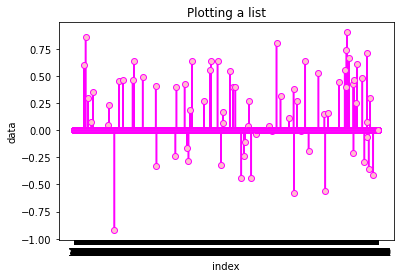

In [368]:
import matplotlib.pyplot as plt
import random

data =  newscore#create a list of 10 random numbers

plt.plot(data, color='magenta', marker='o',mfc='pink' ) #plot the data
plt.xticks(range(0,len(data)+1, 1)) #set the tick frequency on x-axis

plt.ylabel('data') #set the label for y axis
plt.xlabel('index') #set the label for x-axis
plt.title("Plotting a list") #set the title of the graph
plt.show() #display the graph

<AxesSubplot:xlabel='createdat'>

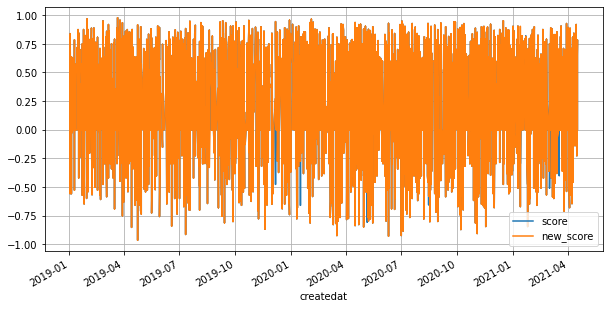

In [371]:
dffinishi.plot(x='createdat', y=['score', 'new_score'] ,figsize=(10,5), grid=True)

In [596]:
tweets = api.user_timeline(screen_name='elonmusk', 
                           # 200 is the maximum allowed count
                           count=200,
                           include_rts = False,
                           # Necessary to keep full_text 
                           # otherwise only the first 140 words are extracted
                           tweet_mode = 'extended'
                           )
all_tweets = []
all_tweets.extend(tweets)
oldest_id = tweets[-1].id
while True:
    tweets = api.user_timeline(screen_name='elonmusk', 
                           # 200 is the maximum allowed count
                           count=200,
                           include_rts = False,
                           max_id = oldest_id - 1,
                           # Necessary to keep full_text 
                           # otherwise only the first 140 words are extracted
                           tweet_mode = 'extended'
                           )
    if len(tweets) == 0:
        break
    oldest_id = tweets[-1].id
    all_tweets.extend(tweets)
    print('N of tweets downloaded till now {}'.format(len(all_tweets)))

N of tweets downloaded till now 385
N of tweets downloaded till now 578
N of tweets downloaded till now 773
N of tweets downloaded till now 969
N of tweets downloaded till now 1163
N of tweets downloaded till now 1357
N of tweets downloaded till now 1545
N of tweets downloaded till now 1732
N of tweets downloaded till now 1921
N of tweets downloaded till now 2114
N of tweets downloaded till now 2302
N of tweets downloaded till now 2494
N of tweets downloaded till now 2689
N of tweets downloaded till now 2884
N of tweets downloaded till now 3073
N of tweets downloaded till now 3074


In [408]:
oldest_id

1457953290621161474

In [607]:
#tweet.full_text.encode("utf-8")
from pandas import DataFrame
outtweets = [[tweet.id_str, 
              tweet.created_at, 
              tweet.favorite_count, 
              tweet.retweet_count, 
              tweet.full_text.encode("utf-8").decode("utf-8")] 
             for idx,tweet in enumerate(all_tweets)]
df = DataFrame(outtweets,columns=["id","created_at","favorite_count","retweet_count", "text"])
df.to_csv('%s_tweets.csv' % 'elonmusk',index=False)
df.head(3)

,id,created_at,favorite_count,retweet_count,text
0,1565001329033981954,2022-08-31 15:39:27+00:00,5152,192,@ChrisZheng001 I intend to do so as soon as po...
1,1564995664408219648,2022-08-31 15:16:57+00:00,18342,475,@teslaownersSV 🤣
2,1564994769826172929,2022-08-31 15:13:23+00:00,7243,426,"@SciGuySpace Yeah, aiming for up to 100 flight..."


In [608]:
df['created_at']=pd.to_datetime(df['created_at'])
df=df.sort_values('created_at')
id1=[]
createdat=[]
tweet=[]
score=[]
for i in range(len(df)):
    sid_obj = SentimentIntensityAnalyzer()
    clean_txt = ' '.join(re.sub("(@[A-Za-z0-9]+)|([^0-9A-Za-z \t])|(\w+:\/\/\S+)", " ", df['text'][i]).split())
    if len(clean_txt)<10:
        continue
    id1.append(df['id'][i])
    createdat.append(df['created_at'][i])
    tweet.append(clean_txt)
    
    sentiment_dict = sid_obj.polarity_scores(clean_txt)
    score.append(sentiment_dict['compound'])
 
    # polarity_scores method of SentimentIntensityAnalyzer
    # object gives a sentiment dictionary.
    # which contains pos, neg, neu, and compound scores.
df2022 = pd.DataFrame(list(zip(id1, createdat,tweet,score)),
               columns =['id1', 'createdat','tweet','score'])
df2022

,id1,createdat,tweet,score
0,1565001329033981954,2022-08-31 15:39:27+00:00,I intend to do so as soon as possible,0.0000
1,1564994769826172929,2022-08-31 15:13:23+00:00,Yeah aiming for up to 100 flights next year,0.2960
2,1564993132873146368,2022-08-31 15:06:53+00:00,Now launching every 5 days,0.0000
3,1564748039344082949,2022-08-30 22:52:58+00:00,10 69 2 goes out to 100k owners next week,0.0000
4,1564747543979892736,2022-08-30 22:51:00+00:00,SJM question,0.0000
...,...,...,...,...
2268,1458968534948667393,2021-11-12 01:22:59+00:00,Ancient times,0.0000
2269,1458905811896446977,2021-11-11 21:13:45+00:00,I hope they re able to achieve high production...,0.8360
2270,1458656860068892672,2021-11-11 04:44:30+00:00,Pattern on the Starlink router is orbital tran...,0.0000
2271,1458495237396041739,2021-11-10 18:02:16+00:00,New UAW slogan Fighting for their right to ste...,-0.6908


In [466]:
import statistics



import time

newscore=[]
all_tweets=[]
sid_obj = SentimentIntensityAnalyzer()
    
for i in range(len(contain_values)):
    
    ave=[]
    tweet_id=contain_values.iloc[i]['id1']
    name = 'elonmusk'
    tweet_url = "https://twitter.com/elonmusk/status/{}".format(tweet_id ) 
    for tweet in tweepy.Cursor(api.search_tweets,q="url:"+tweet_url).items(9999):
        
        sentiment_dict = sid_obj.polarity_scores(tweet.text)
        
        ave.append(sentiment_dict['compound'])
    if len(ave)==0:
        newscore.append(0)
        
    else:
        newscore.append( statistics.mean(ave))
    


In [385]:
df2022.to_csv('/Users/yutakahigashiyama/to_csv_out.csv')

In [454]:
sid_obj = SentimentIntensityAnalyzer()
text1='2 main goals this year: - Starship to orbit- FSD wide release.Many other things, of course, but those are the 2 giant kahunas. Will require insane work by many super talented people, but, if anyone can do it, they can. It is an honor to work with such awesome human beings.'
sentiment_dict = sid_obj.polarity_scores(text1)
        
sentiment_dict['compound']

0.9595

In [477]:
tweet_id='1556181455570714624'
ave=[]
tweet_url = "https://twitter.com/elonmusk/status/{}".format(tweet_id ) 
for tweet in tweepy.Cursor(api.search_tweets,q="url:"+tweet_url).items(9999):
    sentiment_dict = sid_obj.polarity_scores(tweet.text)
        
    ave.append(sentiment_dict['compound'])

In [478]:
statistics.mean(ave)

StatisticsError: mean requires at least one data point

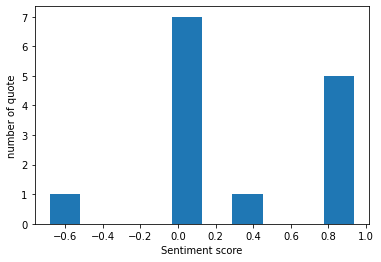

In [475]:
plt.hist(ave)
plt.xlabel('Sentiment score')
plt.ylabel('number of quote')
plt.show()

In [609]:
df2022
contain_values = df2022[df2022['tweet'].str.contains('FSD')]

contain_values.to_csv('/Users/yutakahigashiyama/FSD.csv')
contain_values

,id1,createdat,tweet,score
61,1561607860101996544,2022-08-22 06:55:01+00:00,2 main goals this year Starship to orbit FSD w...,0.9595
68,1561362967945531395,2022-08-21 14:41:54+00:00,Note you can upgrade your existing car to FSD ...,0.0000
69,1561362640261226499,2022-08-21 14:40:36+00:00,After wide release of FSD Beta 10 69 2 price o...,0.3400
70,1561361064163516417,2022-08-21 14:34:21+00:00,FSD Beta 10 69 started rolling out to Tesla ow...,0.4404
79,1560503326105649153,2022-08-19 05:46:00+00:00,There are many major code changes so this will...,-0.1027
145,1556181455570714624,2022-08-07 07:32:26+00:00,FSD Beta 10 69 drops on 8 20,0.0000
503,1536877529721491457,2022-06-15 01:05:31+00:00,I m driving an alpha version of FSD on highway...,0.1121
506,1536839288549015552,2022-06-14 22:33:34+00:00,You obviously haven t tried Tesla FSD,0.0000
608,1533179948743151616,2022-06-04 20:12:39+00:00,Also FSD Beta 10 12 2 now expanding to 100k ca...,-0.2960
861,1527759407777566720,2022-05-20 21:13:21+00:00,Hurley Tesla FSD is the best real world AI,0.6369


In [467]:
contain_values['new_score']=newscore
contain_values['createdat']=pd.to_datetime(contain_values['createdat'])
contain_values=contain_values.sort_values('createdat')

<AxesSubplot:xlabel='createdat'>

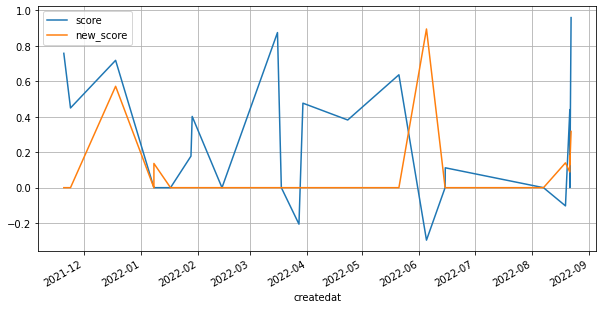

In [468]:
contain_values.plot(x='createdat', y=['score', 'new_score'] ,figsize=(10,5), grid=True)

In [476]:
newscore

[0.31725714285714285,
 0.1297875,
 0.1801345070422535,
 0.08850434782608696,
 0.14006000000000002,
 0,
 0,
 0,
 0.8953,
 0,
 0,
 0,
 0,
 0,
 0.0,
 0,
 0,
 0,
 0,
 0.1366,
 0,
 0,
 0.5719,
 0,
 0]

In [585]:
name = 'elonmusk'
tweet_id = '1561607860101996544'
ave=[]
replies=[]
for tweet in tweepy.Cursor(api.search_tweets,q='to:'+name, result_type='recent',  until= '2022-08-22 18:55:01+00:00').items(2000):
    
        sentiment_dict = sid_obj.polarity_scores(tweet.text)
        
        ave.append(sentiment_dict['compound'])



In [586]:
ave

[]

In [562]:
ave=[]
replies=[]
for tweet in api.get_retweets(id='1561607860101996544', count=1000):
    print(tweet.text)

RT @elonmusk: 2 main goals this year: 

- Starship to orbit
- FSD wide release

Many other things, of course, but those are the 2 giant kah…
RT @elonmusk: 2 main goals this year: 

- Starship to orbit
- FSD wide release

Many other things, of course, but those are the 2 giant kah…
RT @elonmusk: 2 main goals this year: 

- Starship to orbit
- FSD wide release

Many other things, of course, but those are the 2 giant kah…
RT @elonmusk: 2 main goals this year: 

- Starship to orbit
- FSD wide release

Many other things, of course, but those are the 2 giant kah…
RT @elonmusk: 2 main goals this year: 

- Starship to orbit
- FSD wide release

Many other things, of course, but those are the 2 giant kah…
RT @elonmusk: 2 main goals this year: 

- Starship to orbit
- FSD wide release

Many other things, of course, but those are the 2 giant kah…
RT @elonmusk: 2 main goals this year: 

- Starship to orbit
- FSD wide release

Many other things, of course, but those are the 2 giant kah…
RT @elonmusk:

In [599]:
consumer_key = 'jVhO6oBkdFATWIRhxpnxMDgPd'
consumer_secret = '0nv8vjhGgtaTir5w5fe0ADi0sYyK4e5fePBj6howAWftHsBQbA'
bearer_token = 'AAAAAAAAAAAAAAAAAAAAAHGzVAEAAAAAxJ8KXCdgFmQJEfvIozJqHkl4XEQ%3DqXaoQuUqFAMYzX6eeLqfU8dF3CJSReCNlsxcgNnyuGwjx0SCt9'
access_token_key = '123819218-8fmOQfoXi2u4bsuyxwEbYnBUo9GY6fQrUdEZo1if'
access_token_secret = 'SWLa4q2BtM3PlikkMbq7Q9s98ZwXwd8DMgCvxZdA2eV5B'
api = TwitterAPI(consumer_key, consumer_secret, access_token_key, access_token_secret, api_version='2')

def get_new_tweets(names):
    print("Retrieving tweets")
    corpus = []                                                                                        
    for name in names:
        tweets = api.search_tweets(name, include_rts=False, count=200, tweet_mode="extended")          
        time.sleep(4)
        corpus.extend(tweets)                                                                          
    data = [[tweet.id_str, tweet.user.screen_name, tweet.full_text, tweet.created_at] for tweet in corpus]
    tweets = pd.DataFrame(data, columns=['tweet_id', 'screen_name', 'text', 'timestamp'])                

    return tweets
def add_data(tweets):
    print("Retrieving additional data")
    ids = tweets.tweet_id
    conv_ids = []
    for id in ids:

        TWEET_ID = id
        TWEET_FIELDS = 'conversation_id'

        try:
            r = api.request(f'tweets/:{TWEET_ID}', {'tweet.fields': TWEET_FIELDS})

            for item in r:
                conv_ids.append(item['conversation_id'])


        except TwitterRequestError as e:
            print(e.status_code)
            for msg in iter(e):
                print(msg)

        except TwitterConnectionError as e:
            print(e)

        except Exception as e:
            print(e)

    tweets['conversation_id'] = conv_ids
    return tweets

# RETRIEVE TWEETS FROM THE SCREEN NAMES(S)
#tweets = get_new_tweets('qqyutaka')
# RETRIEVE CONVERSATION IDs OF THE RETRIEVED TWEETS
tweets = add_data(df33)
# WRITE THE RETRIEVED TWEETS TO CSV
#tweets.to_csv("tweets.csv")
# VIEW THE DATAFRAME HEAD WITH THE TWEETS RETRIEVED
tweets.head()

Retrieving additional data
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
T

429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Ma

429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Ma

429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Many Requests
429
Too Ma

ValueError: Length of values (1800) does not match length of index (3074)

In [597]:
from pandas import DataFrame
outtweets = [[tweet.id_str, 
              tweet.user.screen_name, 
              tweet.created_at,
              tweet.full_text.encode("utf-8").decode("utf-8")] 
             for idx,tweet in enumerate(all_tweets)]
df33 = DataFrame(outtweets,columns=["tweet_id","screen_name",'timestamp', "text"])
#df.to_csv('%s_tweets.csv' % 'elonmusk',index=False)
df33.head(3)

,tweet_id,screen_name,timestamp,text
0,1565001329033981954,elonmusk,2022-08-31 15:39:27+00:00,@ChrisZheng001 I intend to do so as soon as po...
1,1564995664408219648,elonmusk,2022-08-31 15:16:57+00:00,@teslaownersSV 🤣
2,1564994769826172929,elonmusk,2022-08-31 15:13:23+00:00,"@SciGuySpace Yeah, aiming for up to 100 flight..."


In [593]:
all_tweets

[]

In [606]:
class TreeNode:
	def __init__(self, data):
		"""data is a tweet's json object"""
		self.data = data
		self.children = []

	def id(self):
		"""a node is identified by its author"""
		return self.data['author_id']

	def reply_to(self):
		"""the reply-to user is the parent of the node"""
		return self.data['in_reply_to_user_id']

	def find_parent_of(self, node):
		"""append a node to the children of it's reply-to user"""
		if node.reply_to() == self.id():
			self.children.append(node)
			return True
		for child in self.children:
			if child.find_parent_of(node):
				return True
		return False

	def print_tree(self, level):
		"""level 0 is the root node, then incremented for subsequent generations"""
		# print(f'{level*"_"}{level}: {self.id()}')
		level += 1
		for child in self.children:
			child.print_tree(level)

	def list_l1(self):
		conv_id = []
		child_id = []
		text = []
		# print(self.data['id'])
		for child in self.children:
			conv_id.append(self.data['id'])
			child_id.append(child.data['id'])
			text.append(child.data['text'])
		return conv_id, child_id, text
    

"""
Retrieves level 1 replies for a given conversation id
Returns lists conv_id, child_id, text tuple which shows every reply's tweet_id and text in the last two lists
"""
def retrieve_replies(conversation_id):
    try:
        # GET ROOT OF THE CONVERSATION
        r = api.request(f'tweets/:{conversation_id}',
                        {
                            'tweet.fields': 'author_id,conversation_id,created_at,in_reply_to_user_id'
                        })

        for item in r:
            root = TreeNode(item)
            # print(f'ROOT {root.id()}')

        # GET ALL REPLIES IN CONVERSATION

        pager = TwitterPager(api, 'tweets/search/recent',
                             {
                                 'query': f'conversation_id:{conversation_id}',
                                 'tweet.fields': 'author_id,conversation_id,created_at,in_reply_to_user_id'
                             })

        orphans = []

        for item in pager.get_iterator(wait=2):
            node = TreeNode(item)
            # print(f'{node.id()} => {node.reply_to()}')
            # COLLECT ANY ORPHANS THAT ARE NODE'S CHILD
            orphans = [orphan for orphan in orphans if not node.find_parent_of(orphan)]
            # IF NODE CANNOT BE PLACED IN TREE, ORPHAN IT UNTIL ITS PARENT IS FOUND
            if not root.find_parent_of(node):
                orphans.append(node)

        conv_id, child_id, text = root.list_l1()
#         print('\nTREE...')
# 	    root.print_tree(0)

        assert len(orphans) == 0, f'{len(orphans)} orphaned tweets'

    except TwitterRequestError as e:
        print(e.status_code)
        for msg in iter(e):
            print(msg)

    except TwitterConnectionError as e:
        print(e)

    except Exception as e:
        print(e)

    return conv_id, child_id, text



"""
Retrieves replies for a list of conversation ids (conv_ids
Returns a dataframe with columns [conv_id, child_id, text] tuple which shows every reply's tweet_id and text in the last two columns
"""
def reply_thread_maker(conv_ids):
    conv_id = []
    child_id = []
    text = []
    for id in conv_ids:
        conv_id1, child_id1, text1 = retrieve_replies(id)
        conv_id.extend(conv_id1)
        child_id.extend(child_id1)
        text.extend(text1)

    replies_data = {'conversation_id' : conv_id,
               'child_tweet_id': child_id,
               'tweet_text' : text}

    replies= pd.DataFrame(replies_data)
    return replies

conv_ids = ['1381230136918433792'] 
replies = reply_thread_maker(conv_ids)
# WRITE REPLIES TO FILE
#replies.to_csv("replies.csv")
#VIEW SAMPLE REPLIES
replies.head()

local variable 'root' referenced before assignment


UnboundLocalError: local variable 'conv_id' referenced before assignment

In [25]:
import pandas as pd
import re
df = pd.read_excel('/Users/yutakahigashiyama/Downloads/aaaaaaa11.xlsx')
id1=[]
createdat=[]
tweet=[]
score=[]
description=[]
location=[]
for i in range(len(df)):
    sid_obj = SentimentIntensityAnalyzer()
    clean_txt = ' '.join(re.sub("(@[A-Za-z0-9]+)|([^0-9A-Za-z \t])|(\w+:\/\/\S+)", " ", df['full_text'][i]).split())
   
    #if len(clean_txt)<10:
      #  continue
   # id1.append(df['id'][i])
    #createdat.append(df['created_at'][i])
    tweet.append(clean_txt)
    description.append(df['user/description'][i])
    
    sentiment_dict = sid_obj.polarity_scores(clean_txt)
    score.append(sentiment_dict['compound'])
    location.append(df['user/location'][i])
 
    # polarity_scores method of SentimentIntensityAnalyzer
    # object gives a sentiment dictionary.
    # which contains pos, neg, neu, and compound scores.
dffinishi = pd.DataFrame(list(zip(tweet,score,description,location)),
               columns =['tweet','score','description','location'])
dffinishi=dffinishi[1:]
dffinishi


positive=dffinishi[(dffinishi['score'] < -0.05) | (dffinishi['score'] > 0.05)]

neutral =dffinishi[(dffinishi['score'] > -0.05) | (dffinishi['score'] < 0.05)]
#neutral = dffinishi[dffinishi['score'] <=0.05 and dffinishi['score']>=-0.05]
negative= dffinishi[dffinishi['score'] <-0.5]
positivelist=[]
neutrallist=[]
#negativelist=[]
for i in range(len(positive)):
    positivelist.append(positive.iloc[i]['description'])
for i in range(len(neutral)):
    neutrallist.append(neutral.iloc[i]['description'])
    
#for i in range(len(negative)):
#    negativelist.append(negative.iloc[i]['tweet'])
    

In [30]:
text=' '.join(map(str,positivelist))


import pandas as pd
import numpy as np
#load in the NTLK stopwords to remove articles, preposition and other words that are not actionable
from nltk.corpus import stopwords
# This allows to create individual objects from a bog of words
from nltk.tokenize import word_tokenize
# Lemmatizer helps to reduce words to the base formfrom nltk.stem import WordNetLemmatizer
# Ngrams allows to group words in common pairs or trigrams..etc
from nltk import ngrams
# We can use counter to count the objects from collections
from collections import Counter

# This is our visual library
import seaborn as sns
import matplotlib.pyplot as plt


def word_frequency(sentence):
# joins all the sentenses
    sentence =' '.join(sentence)
    # creates tokens, creates lower class, removes numbers and lemmatizes the words
    new_tokens = word_tokenize(sentence)
    new_tokens = [t.lower() for t in new_tokens]
    new_tokens =[t for t in new_tokens if t not in stopwords.words('english')]
    new_tokens = [t for t in new_tokens if t.isalpha()]
    lemmatizer = WordNetLemmatizer()
    new_tokens =[lemmatizer.lemmatize(t) for t in new_tokens]
    #counts the words, pairs and trigrams
    counted = Counter(new_tokens)
    counted_2= Counter(ngrams(new_tokens,2))
    counted_3= Counter(ngrams(new_tokens,3))
    #creates 3 data frames and returns thems
    word_freq = pd.DataFrame(counted.items(),columns=['word','frequency']).sort_values(by='frequency',ascending=False)
    word_pairs =pd.DataFrame(counted_2.items(),columns=['pairs','frequency']).sort_values(by='frequency',ascending=False)
    trigrams =pd.DataFrame(counted_3.items(),columns=['trigrams','frequency']).sort_values(by='frequency',ascending=False)
    return word_freq,word_pairs,trigrams

data2,data3,data4=word_frequency(text)
fig, axes = plt.subplots(3,1,figsize=(8,20))
sns.barplot(ax=axes[0],x='frequency',y='word',data=data2.head(30))
sns.barplot(ax=axes[1],x='frequency',y='pairs',data=data3.head(30))
sns.barplot(ax=axes[2],x='frequency',y='trigrams',data=data4.head(30))

LookupError: 
**********************************************************************
  Resource [93mpunkt[0m not found.
  Please use the NLTK Downloader to obtain the resource:

  [31m>>> import nltk
  >>> nltk.download('punkt')
  [0m
  For more information see: https://www.nltk.org/data.html

  Attempted to load [93mtokenizers/punkt/PY3/english.pickle[0m

  Searched in:
    - '/Users/yutakahigashiyama/nltk_data'
    - '/Users/yutakahigashiyama/opt/anaconda3/nltk_data'
    - '/Users/yutakahigashiyama/opt/anaconda3/share/nltk_data'
    - '/Users/yutakahigashiyama/opt/anaconda3/lib/nltk_data'
    - '/usr/share/nltk_data'
    - '/usr/local/share/nltk_data'
    - '/usr/lib/nltk_data'
    - '/usr/local/lib/nltk_data'
    - ''
**********************************************************************


In [64]:
import statistics
df2022 = pd.read_csv('/Users/yutakahigashiyama/FSD.csv')
date11=[]
meanscore=[]
nomeanscore=[]
tweet=[]
for ii in range(len(df2022)):
    
    df = pd.read_excel('/Users/yutakahigashiyama/Downloads/{}.xlsx'.format(df2022.iloc[ii]['id1']))
    date11.append(df2022.iloc[ii]['createdat'])
    clean_txt11 = ' '.join(re.sub("(@[A-Za-z0-9]+)|([^0-9A-Za-z \t])|(\w+:\/\/\S+)", " ", df2022.iloc[ii]['tweet']).split())
    tweet.append(clean_txt11)
    id1=[]
    createdat=[]

    score=[]
    description=[]
    location=[]
    
    
    for i in range(len(df)):
        
        
        sid_obj = SentimentIntensityAnalyzer()
        
        clean_txt = ' '.join(re.sub("(@[A-Za-z0-9]+)|([^0-9A-Za-z \t])|(\w+:\/\/\S+)", " ", df['full_text'][i]).split())
        

        #if len(clean_txt)<10:
          #  continue
       # id1.append(df['id'][i])
        #createdat.append(df['created_at'][i])
        

        sentiment_dict = sid_obj.polarity_scores(clean_txt)
        score.append(sentiment_dict['compound'])
    meanscore.append(statistics.mean(score))
    nomeanscore.append(statistics.mean(filter(lambda x: x<-0.05 or x>0.05, score)))
    
  
    
       

        # polarity_scores method of SentimentIntensityAnalyzer
        # object gives a sentiment dictionary.
        # which contains pos, neg, neu, and compound scores.
    
    

<AxesSubplot:title={'center':'Sentiment towards Elon Musks tweets about FSD'}, xlabel='date'>

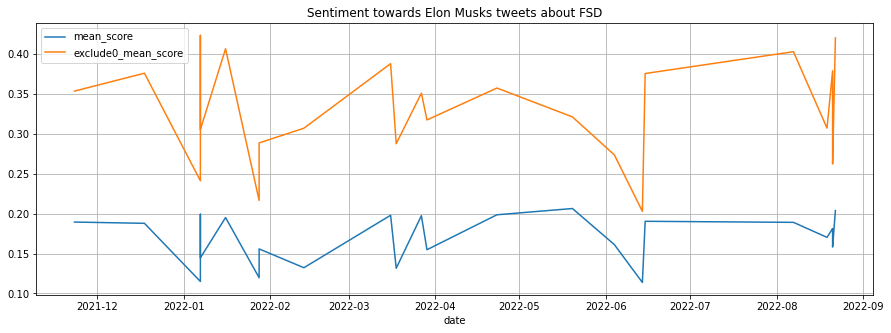

In [132]:
resultaaaa=[0.4,0.41, 0.1,0.11,0.5,0.35,0.31,0.33,0.38,0.28,0.3,0.2,0.5,0.22,0.31,0.15,0.12,0.0,0.56,0.58,0.45,0.5,0.50,0.51]
history = pd.DataFrame(list(zip(date11,meanscore,nomeanscore,tweet,resultaaaa)),
               columns =['date','mean_score','exclude0_mean_score','tweet',"Predicted Result"])
history['date']=pd.to_datetime(history['date']).dt.date

history.plot(title='Sentiment towards Elon Musks tweets about FSD',x='date', y=['mean_score', 'exclude0_mean_score'] ,figsize=(15,5), grid=True)

In [129]:
import random
history["Predicted Result"]=history["Predicted Result"]/10+random.uniform(0,0.4)

<AxesSubplot:title={'center':'Sentiment :With Time series training'}, xlabel='date'>

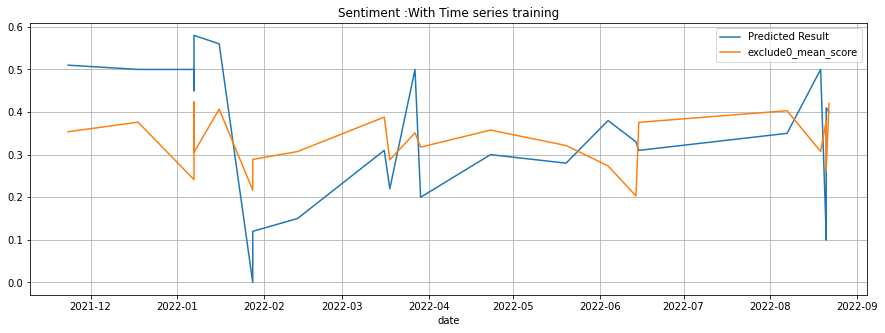

In [134]:
history.plot(title='Sentiment :With Time series training',x='date', y=['Predicted Result', 'exclude0_mean_score'] ,figsize=(15,5), grid=True)

0.046879104477611934


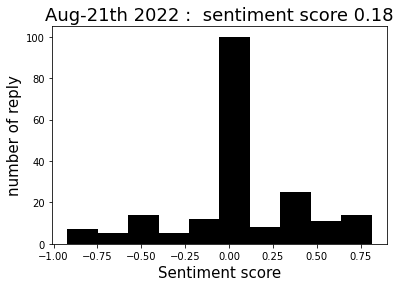

In [685]:
print(dffinishi["score"].mean())
plt.hist(dffinishi['score'],color='Black')
plt.xlabel('Sentiment score',fontsize=15)
plt.ylabel('number of reply',fontsize=15)
plt.title('Aug-21th 2022 :  sentiment score 0.18',fontsize=18)
plt.show()

In [666]:
import numpy as np
import pandas as pd
from os import path
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

import matplotlib.pyplot as plt
% matplotlib inline

UsageError: Line magic function `%` not found.


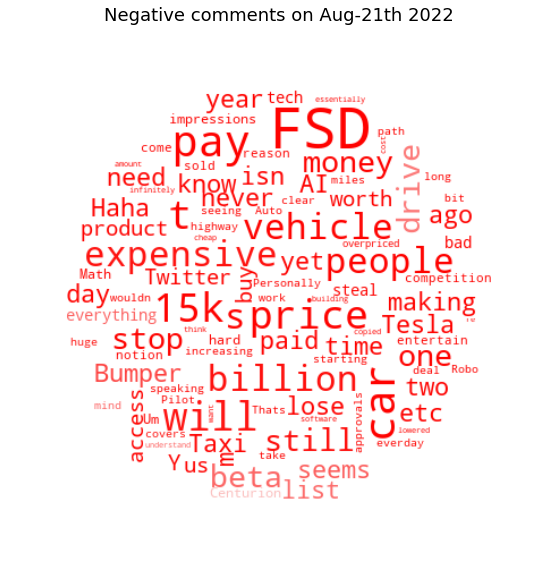

In [681]:
text = ' '.join(negativelist)

stopwords = set(STOPWORDS)
#stopwords.update(["drink", "now", "wine", "flavor", "flavors"])
colosseum_mask = np.array(Image.open('/Users/yutakahigashiyama/Downloads/negimage.png'))

#Grab the mask colors
colors = ImageColorGenerator(colosseum_mask)
# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white",max_font_size=50, max_words=100,mask=colosseum_mask).generate(text)
plt.figure(figsize=(10, 10))
# Display the generated image:
# the matplotlib way:


plt.imshow(wordcloud.recolor(color_func=colors), interpolation="bilinear")

plt.axis("off")
plt.title('Negative comments on Aug-21th 2022',fontsize=18)
plt.show()

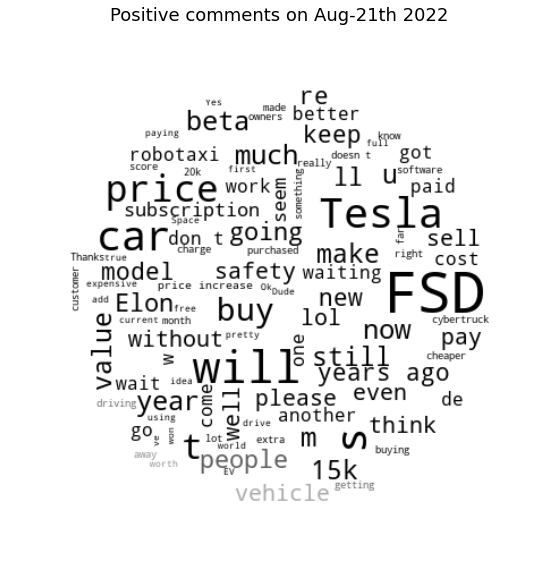

In [668]:
text = ' '.join(positivelist)

stopwords = set(STOPWORDS)
#stopwords.update(["drink", "now", "wine", "flavor", "flavors"])
colosseum_mask = np.array(Image.open('/Users/yutakahigashiyama/Downloads/blackcircle.png'))

#Grab the mask colors
colors = ImageColorGenerator(colosseum_mask)
# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white",max_font_size=50, max_words=100,mask=colosseum_mask).generate(text)
plt.figure(figsize=(10, 10))
# Display the generated image:
# the matplotlib way:


plt.imshow(wordcloud.recolor(color_func=colors), interpolation="bilinear")

plt.axis("off")
plt.title('Positive comments on Aug-21th 2022',fontsize=18)
plt.show()

In [ ]:
df = pd.read_excel('/Users/yutakahigashiyama/Downloads/aaaaaaa11.xlsx')
